In [1]:
# hack to make notebook appear full-width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import math
import csv
import pickle
from collections import namedtuple, defaultdict
import time
from glob import glob
import numpy as np
from scipy.sparse import csr_matrix

import matplotlib.pyplot as plt
from matplotlib.patches import Patch, Circle, ConnectionPatch

import mapalgo
import viewmap
import vast11data as vast

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [3]:
import importlib
importlib.reload(vast)
importlib.reload(viewmap)
importlib.reload(mapalgo)

<module 'mapalgo' from '/Users/dbeach/Desktop/stableyes/src/mapalgo.py'>

In [4]:
data = pickle.load(open("../data/vast11-connections-by-port.pickle", "rb"))
start_times = data["start_times"]
snapshots = data["snapshots"]

In [5]:
def fmt_time(s):
    t = time.gmtime(start_times[s])
    return time.strftime("%H:%M", t)

In [6]:
def get_windows(start=0, stop=len(snapshots["all"]), step=4, window=4):
    for t in range(start, stop, step):
        s1 = t - 1
        s2 = s1 + window
        yield (s1, s2)
    

def timeseries_maps_weights(name, getcounts, windows):
    prior = None
    pmaps = []
    weightmaps = []
    for s1, s2 in windows:
        counts = getcounts(s2)
        if s1 >= 0:
            counts = counts - getcounts(s1)
        counts = counts.toarray()
        nodeweights = np.sum(counts + 1, 1)
        weightmaps.append(nodeweights)
        p = mapalgo.weights_to_condprob(counts)
        idx = np.sum(p, 1) > 0
        p[np.ix_(idx, idx)] = np.maximum(0.001, p[np.ix_(idx, idx)])
        pdecay = mapalgo.propagate_with_decay(p, n=4, gamma=0.50)
        pmap = mapalgo.create_map("{} - {}".format(name, fmt_time(s1+1)), pdecay, prior=prior)
        prior = pmap
        pmaps.append(pmap)
    return pmaps, weightmaps


def view_timeseries(pmaps, weightmaps, ncols=6, size=10):
    graph_props = []
    for weights in weightmaps:
        props = vast.VAST11GraphProps({i: w for i, w in enumerate(weights)})
        graph_props.append(props)
    viewmap.show_maps(pmaps, props=graph_props, ncols=ncols, size=size)

In [7]:
def multi_timeseries(names, getcounts, windows):
    k = len(names)
    assert len(getcounts) == k, "names and getcounts lists must correspond"
    prior = None
    series = [[] for i in range(k)]
    for s1, s2 in windows:
        for a in range(k):
            counts = getcounts[a](s2)
            if s1 >= 0:
                counts = counts - getcounts[a](s1)
            counts = counts.toarray()
            nodeweights = np.sum(counts + 1, 1)
            p = mapalgo.weights_to_condprob(counts)
            idx = np.sum(p, 1) > 0
            p[np.ix_(idx, idx)] = np.maximum(0.001, p[np.ix_(idx, idx)])
            pdecay = mapalgo.propagate_with_decay(p, n=4, gamma=0.50)
            pmap = mapalgo.create_map("{} - {}".format(names[a], fmt_time(s1+1)), pdecay, prior=prior)
            if a == 0:
                prior = pmap
            series[a].append((pmap, nodeweights))
    return series

def view_multi_timeseries(series, size=10):
    k = len(series)
    n = len(series[0])

    for i in range(n):
        pmaps = []
        graph_props = []
        for a in range(k):
            pmap, weights = series[a][i]
            props = vast.VAST11GraphProps({j: w for j, w in enumerate(weights)})
            graph_props.append(props)
            pmaps.append(pmap)
        viewmap.show_maps(pmaps, props=graph_props, ncols=k, size=size)

In [8]:
series = multi_timeseries(["All", "RPC", "LDAP", "Web/SSH"], [
    lambda t: snapshots["all"][t],
    lambda t: snapshots[135][t],
    lambda t: snapshots[389][t],
    lambda t: snapshots[80][t] + snapshots[21][t] + snapshots[443][t] + snapshots[22][t]
], get_windows())

/Users/dbeach/Desktop/stableyes/src/mapalgo.py:341: RuntimeWarning: invalid value encountered in true_divide
  p /= np.sum(p)
/Users/dbeach/Desktop/stableyes/src/mapalgo.py:372: RuntimeWarning: invalid value encountered in greater
  keep = np.sum(prob, 1) > 1e-6


/usr/local/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


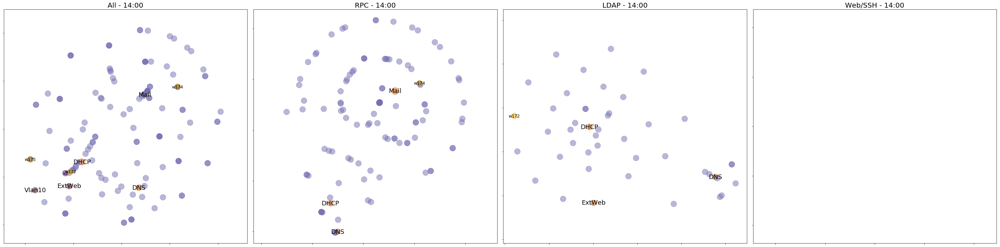

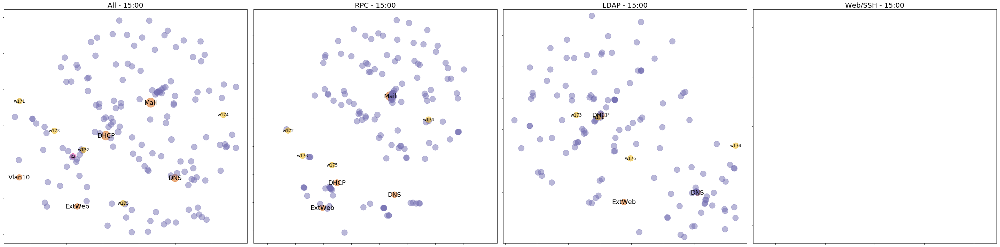

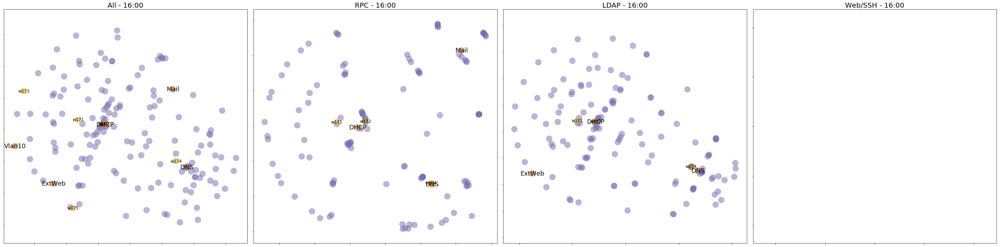

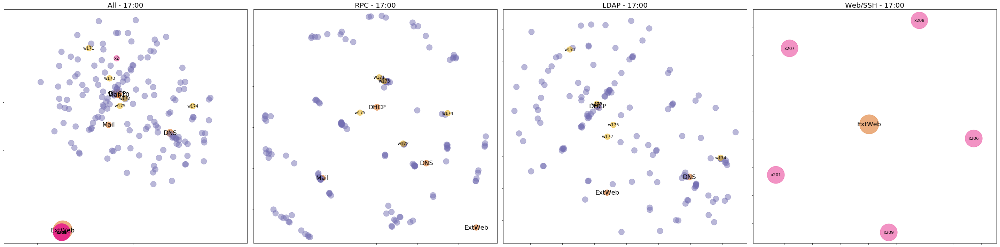

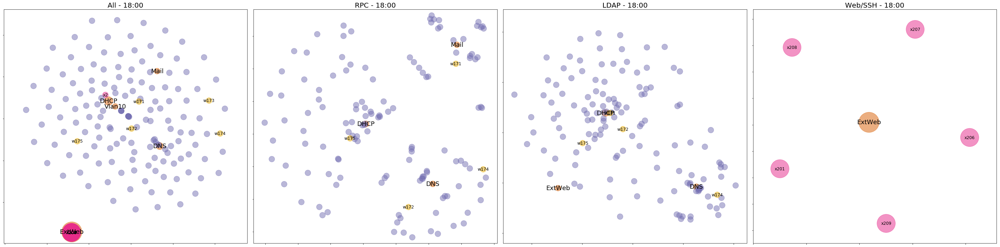

...

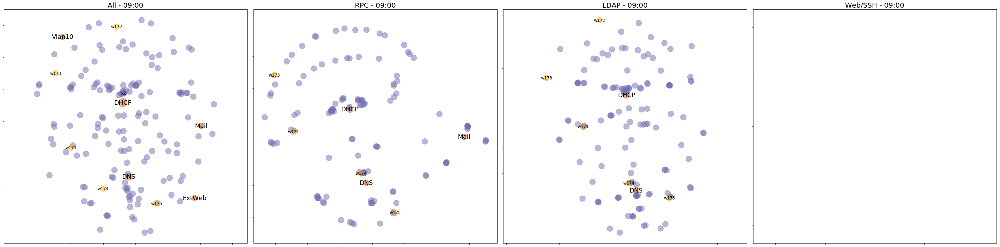

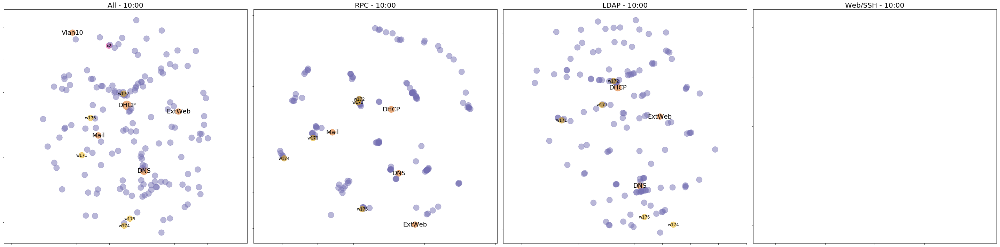

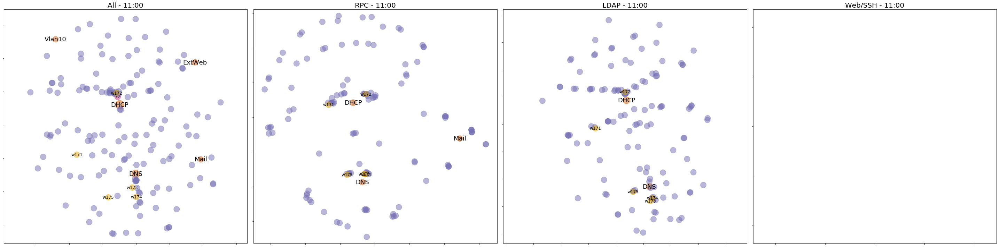

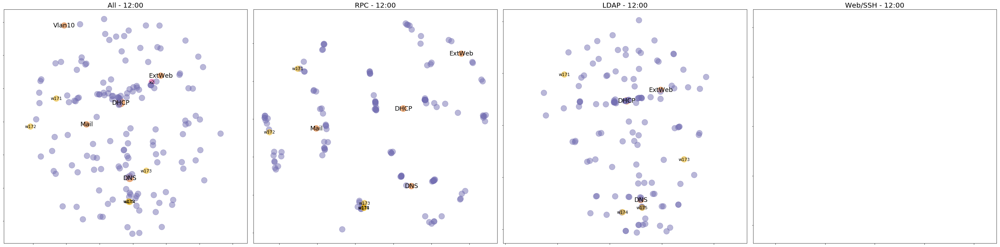

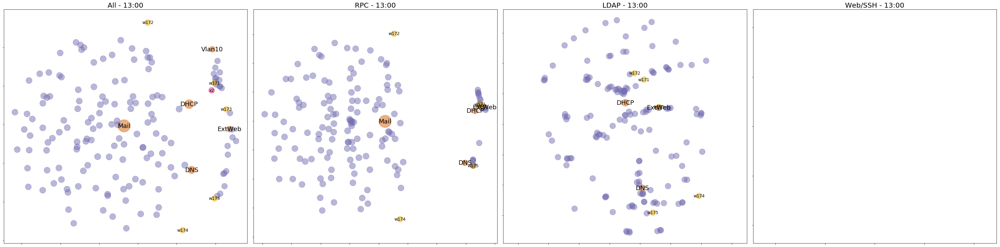

In [9]:
view_multi_timeseries(series)

In [15]:
def plot_tallies(name, k=3, s=4):
    T = len(snapshots["all"])
    fpos = next(n.id for n in vast.NODES if n.name == name)
    trows = np.zeros((T, len(vast.NODES)))
    for t in range(T):
        last = min(t + s, T-1)
        first = t - s
        tallies = snapshots["all"][last][fpos,:]
        if first > 0:
            tallies -= snapshots["all"][first][fpos,:]
        trows[t] = tallies.toarray()
    trows *= 4 / (2*s)
    tsums = np.sum(trows, 0)
    sortidx = np.argsort(tsums)[::-1]
    xvals = np.arange(T, dtype=float)
    xvals *= 0.25
    plt.figure(figsize=(20,5))
    for i in range(k):
        idx = sortidx[i]
        yvals = trows[:,idx]
        plt.plot(xvals, yvals, label=vast.NODES[idx].name)
    plt.xlim(0.0, T*0.25)
    plt.ylim(0.0, np.max(trows) * 1.05)
    plt.xlabel("Time (hours)")
    plt.ylabel("Connections / hour")
    plt.legend()
    plt.title("Connections with {}".format(name))
    plt.show()

    

In [16]:
def plot_cp_relation(name, k=3, s=4):
    T = len(snapshots["all"])
    fpos = next(n.id for n in vast.NODES if n.name == name)
    cprows = np.zeros((T, len(vast.NODES)))
    for t in range(T):
        last = min(t + s, T-1)
        first = t - s
        tallies = snapshots["all"][last].toarray()
        if first > 0:
            tallies -= snapshots["all"][first].toarray()
        condprob = mapalgo.weights_to_condprob(tallies)
        cprows[t] = condprob[fpos,:]
    cpsums = np.sum(cprows, 0)
    cpsums /= T
    sortidx = np.argsort(cpsums)[::-1]
    xvals = np.arange(T, dtype=float)
    xvals *= 0.25
    stackvals = [cprows[:,sortidx[i]] for i in range(k)]
    labels = ["{} {:6.2%}".format(vast.NODES[sortidx[i]].name, cpsums[sortidx[i]]) for i in range(k)]
    yvals = np.stack(stackvals)
    yvals *= 100.0
    plt.figure(figsize=(20,5))
    plt.stackplot(xvals, yvals, labels=labels)
    plt.xlim(0.0, T*0.25)
    plt.ylim(0.0, 100.0)
    plt.xlabel("Time (hours)")
    plt.ylabel("Connections with {} (%)".format(name))
    
    plt.legend()
    plt.title("Probability conditioned on {}".format(name))
    plt.show()

    

In [19]:
def plot_cp_relation2(name, k=3, s=4):
    T = len(snapshots["all"])
    fpos = next(n.id for n in vast.NODES if n.name == name)
    cprows = np.zeros((T, len(vast.NODES)))
    for t in range(T):
        last = min(t + s, T-1)
        first = t - s
        tallies = snapshots["all"][last].toarray()
        if first > 0:
            tallies -= snapshots["all"][first].toarray()
        condprob = mapalgo.weights_to_condprob(tallies)
        condprob2 = mapalgo.propagate_with_decay(condprob, gamma=0.1, n=3)
        np.fill_diagonal(condprob2, 0.0)
        condprob2 /= np.sum(condprob2, axis=1).reshape((-1,1))
        cprows[t] = condprob2[fpos,:]
    cpsums = np.sum(cprows, 0)
    cpsums /= T
    sortidx = np.argsort(cpsums)[::-1]
    xvals = np.arange(T, dtype=float)
    xvals *= 0.25
    stackvals = [cprows[:,sortidx[i]] for i in range(k)]
    labels = ["{} {:6.2%}".format(vast.NODES[sortidx[i]].name, cpsums[sortidx[i]]) for i in range(k)]
    yvals = np.stack(stackvals)
    yvals *= 100.0
    plt.figure(figsize=(20,5))
    plt.stackplot(xvals, yvals, labels=labels)
    plt.xlim(0.0, T*0.25)
    plt.ylim(0.0, 100.0)
    plt.xlabel("Time (hours)")
    plt.ylabel("Connections with {} (%)".format(name))
    
    plt.legend()
    plt.title("Probability conditioned on {}".format(name))
    plt.show()


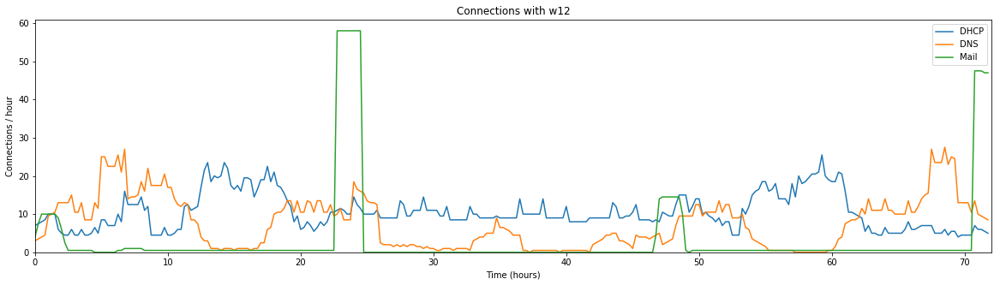

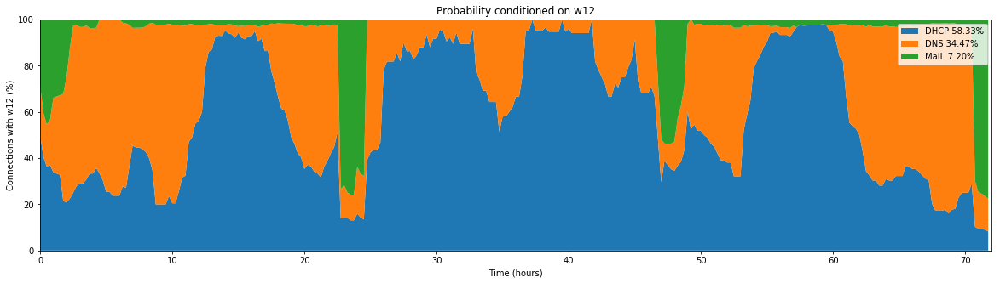

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


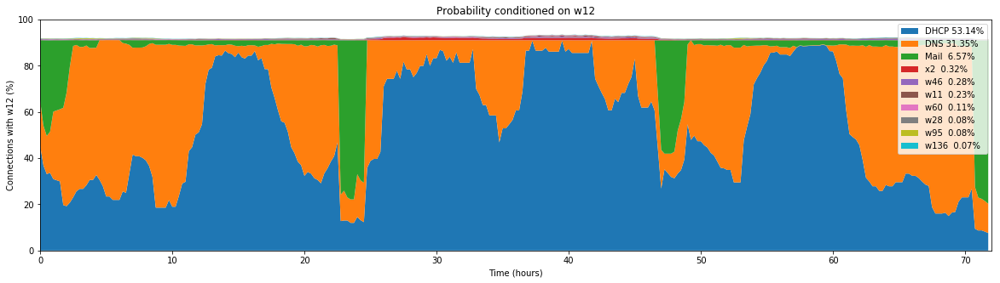

In [20]:
plot_tallies("w12", k=3)
plot_cp_relation("w12", k=3)
plot_cp_relation2("w12", k=10)

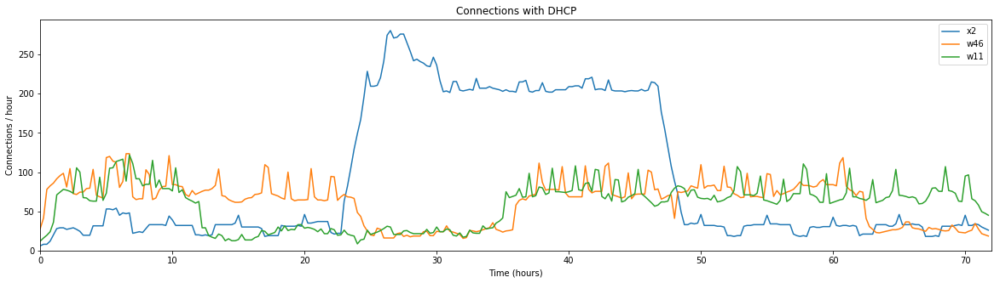

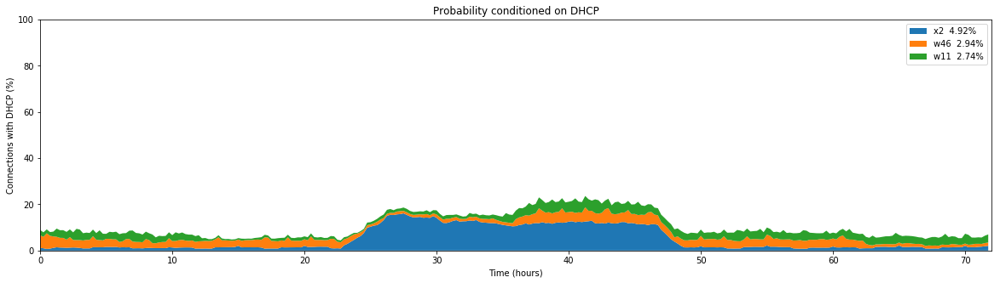

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


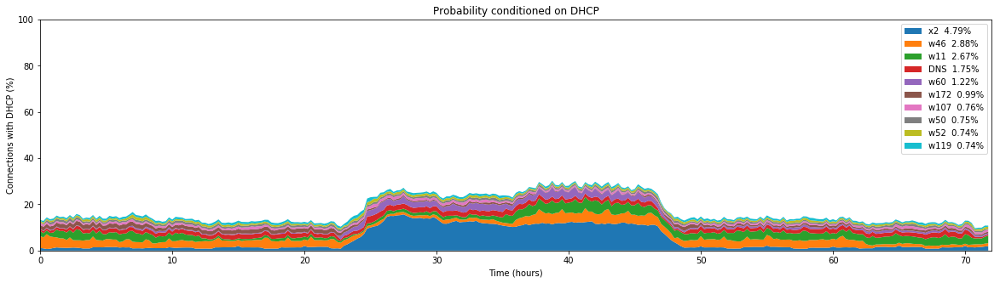

In [21]:
plot_tallies("DHCP", k=3)
plot_cp_relation("DHCP", k=3)
plot_cp_relation2("DHCP", k=10)

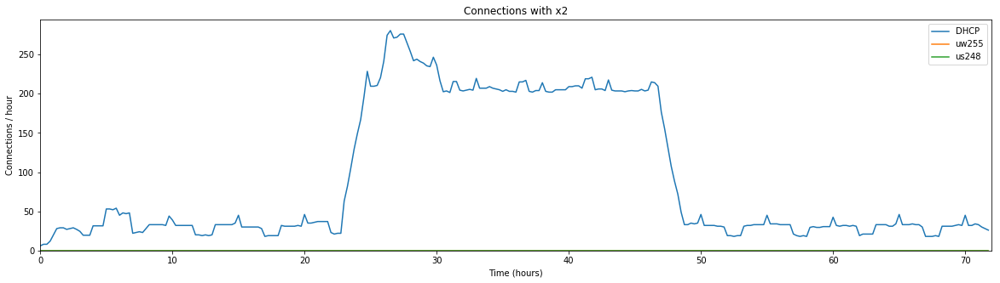

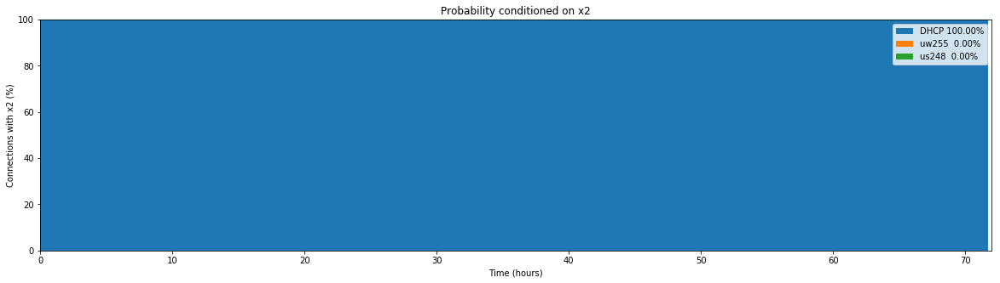

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


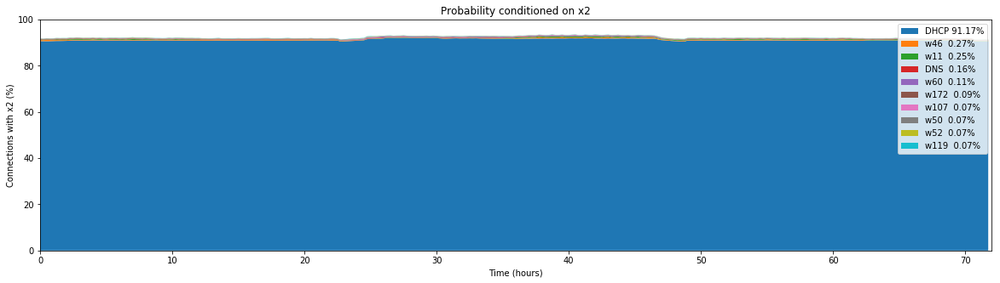

In [22]:
plot_tallies("x2", k=3)
plot_cp_relation("x2", k=3)
plot_cp_relation2("x2", k=10)

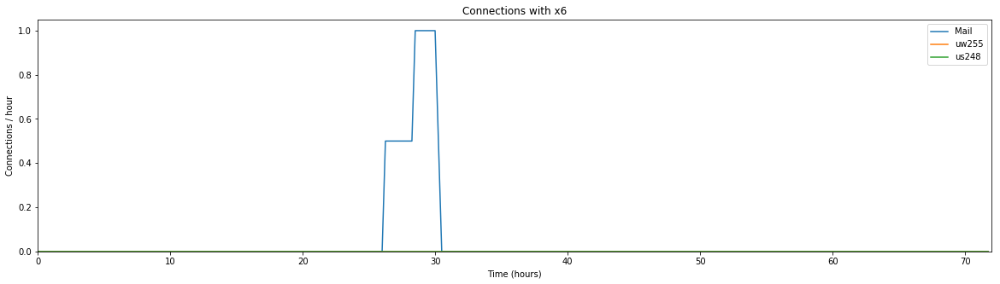

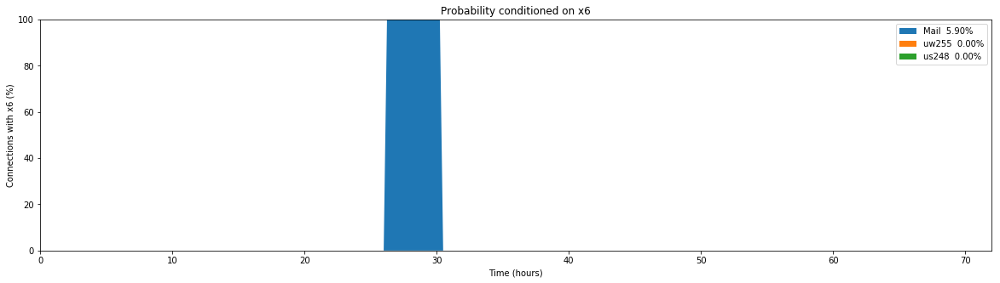

In [23]:
plot_tallies("x6", k=3)
plot_cp_relation("x6", k=3)

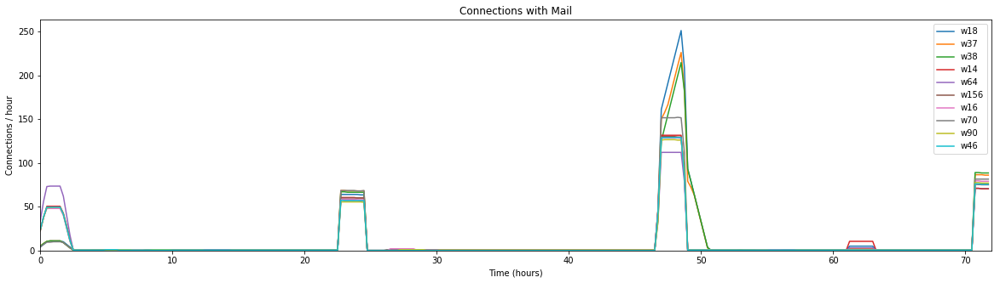

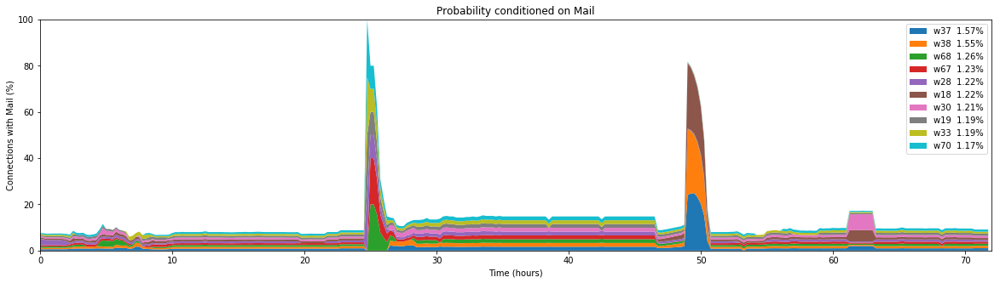

In [24]:
plot_tallies("Mail", k=10)
plot_cp_relation("Mail", k=10)

In [26]:
all_maps, all_weights = zip(*series[0])

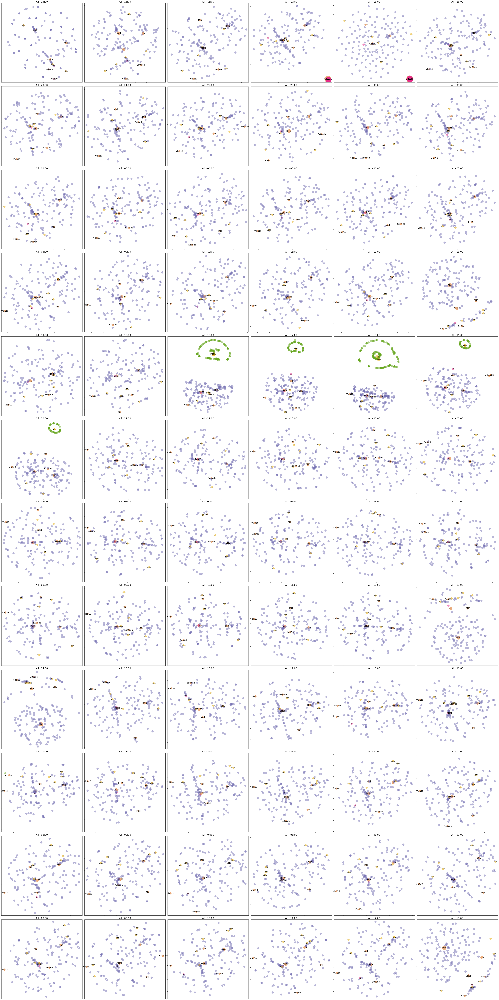

In [27]:
view_timeseries(all_maps, all_weights)

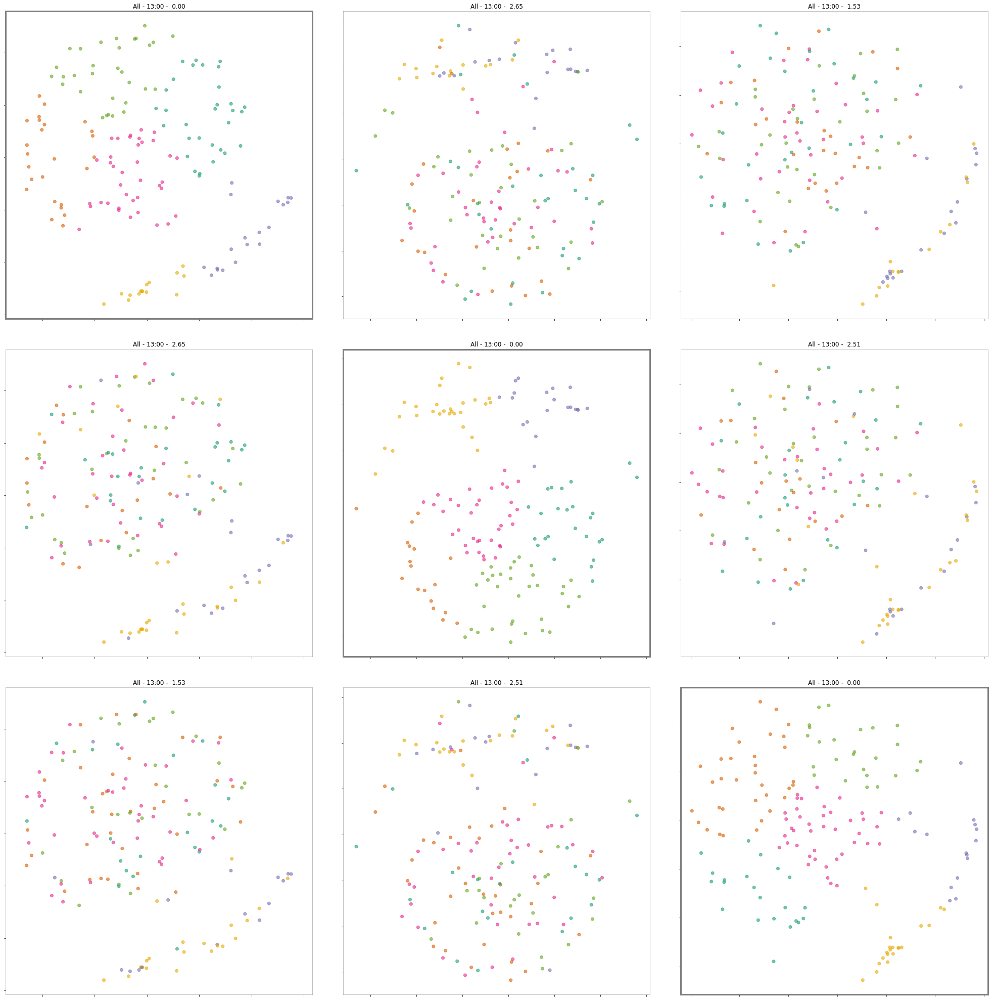

In [28]:
viewmap.show_map_matrix(all_maps[23::24], size=30)

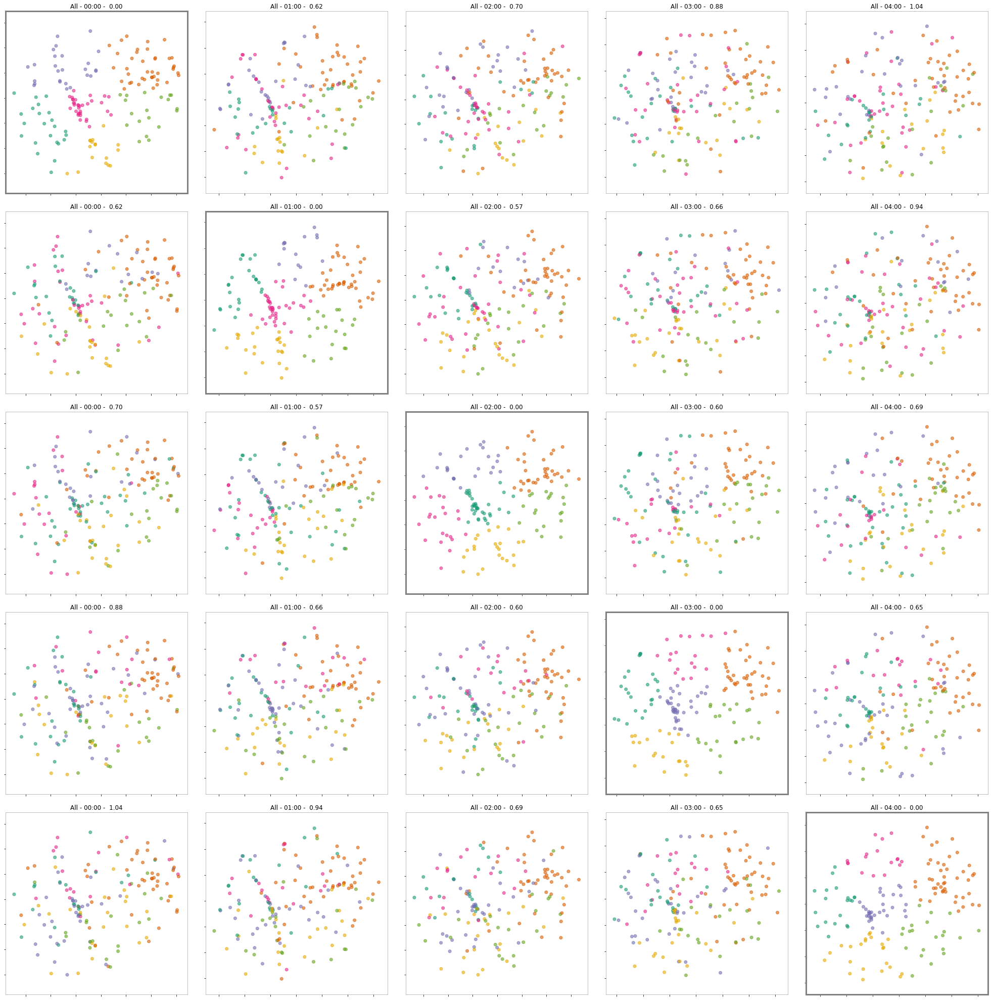

In [29]:
viewmap.show_map_matrix(all_maps[10:15], size=30)

In [30]:
smaps, sweights = timeseries_maps_weights("All", lambda t: snapshots["all"][t], get_windows(start=105, stop=117, step=1, window=4))

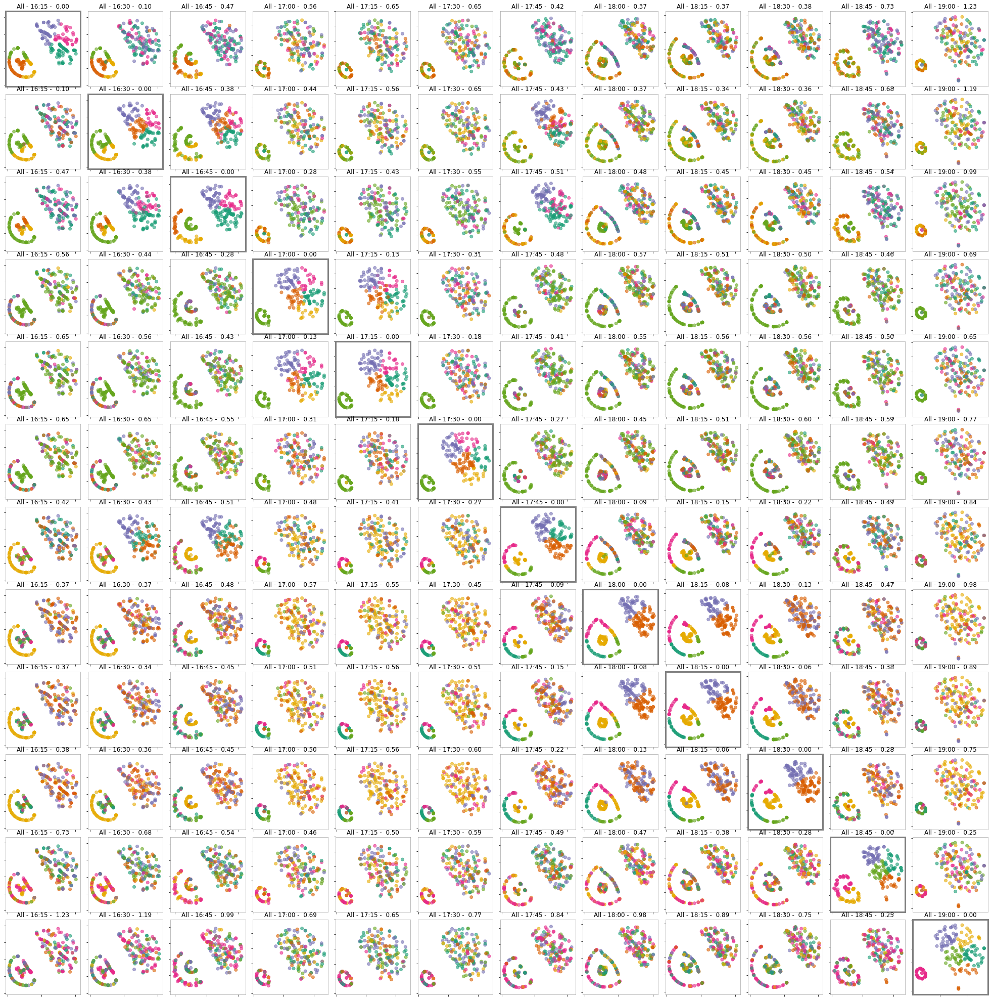

In [31]:
viewmap.show_map_matrix(smaps, size=30)

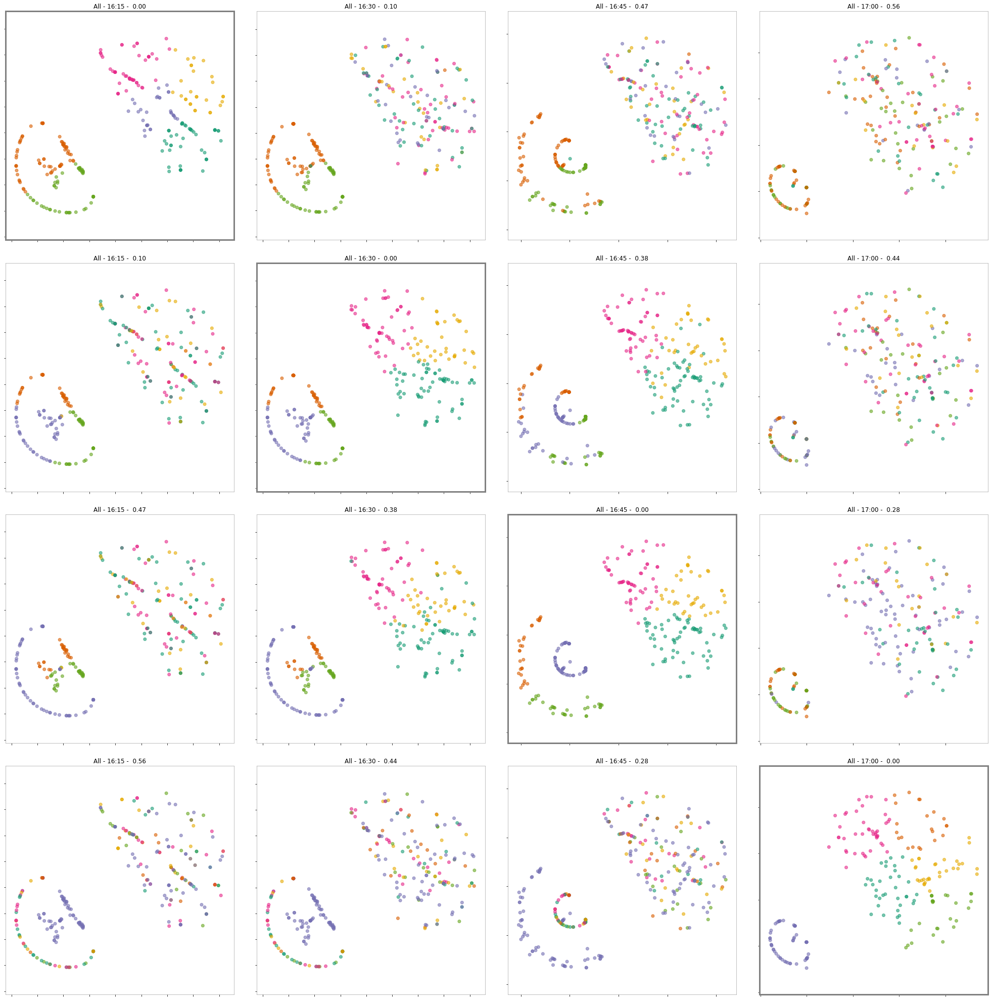

In [32]:
viewmap.show_map_matrix(smaps[0:4], size=30)